In [1]:
from PIL import Image, ImageEnhance
import math

In [2]:
import cv2

In [3]:
from matplotlib import pyplot as plt

In [4]:
image_file = "E:/ADB_Project/code/data/cs_sample/600087.png"
img = cv2.imread(image_file)

In [5]:
import pytesseract

# loading pytesseract 
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract'

In [6]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()
    

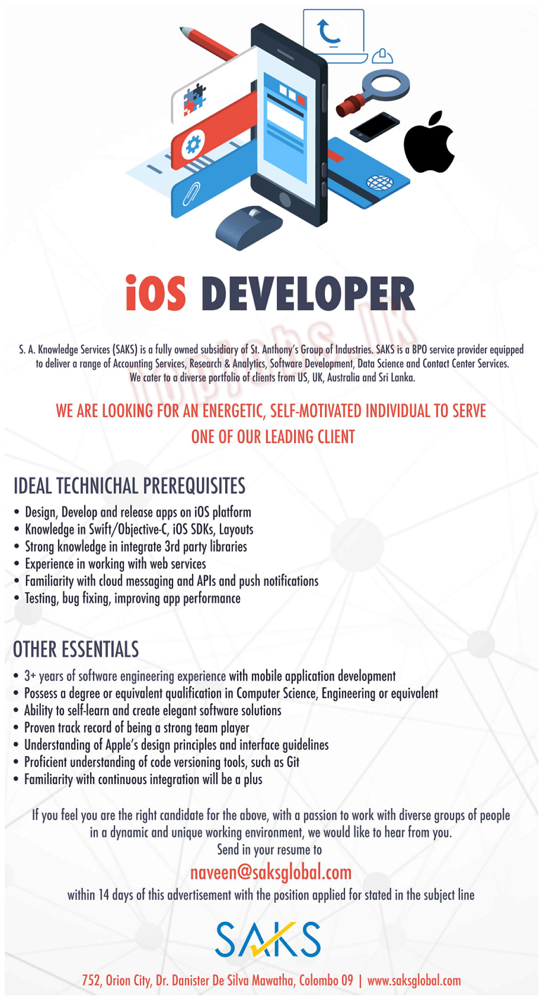

In [7]:
display(image_file)

## 01: Inverted Images

In [9]:
inverted_image = cv2.bitwise_not(img)

In [14]:
cv2.imwrite("temp/inverted.jpg", inverted_image)

True

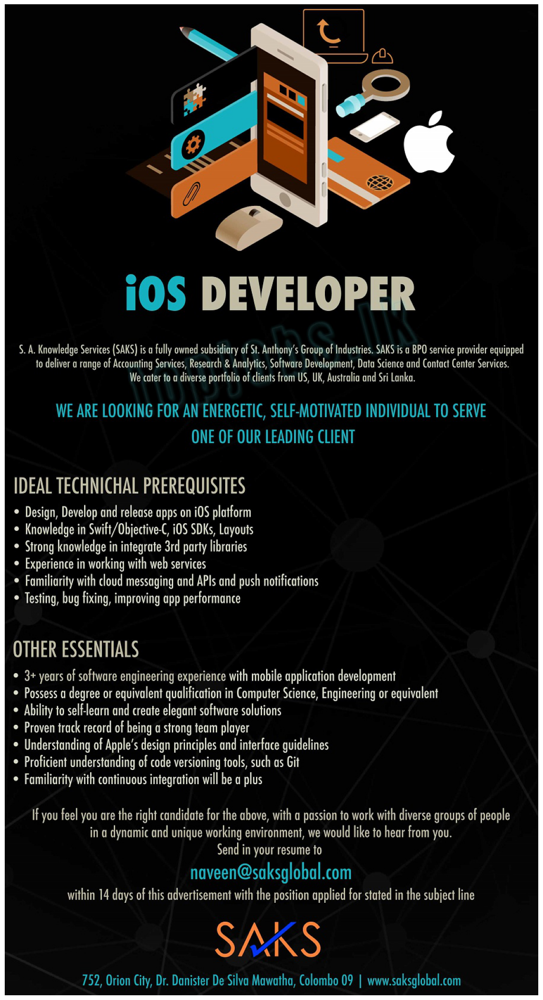

In [8]:
display("temp/inverted.jpg")

## 02: Rescaling

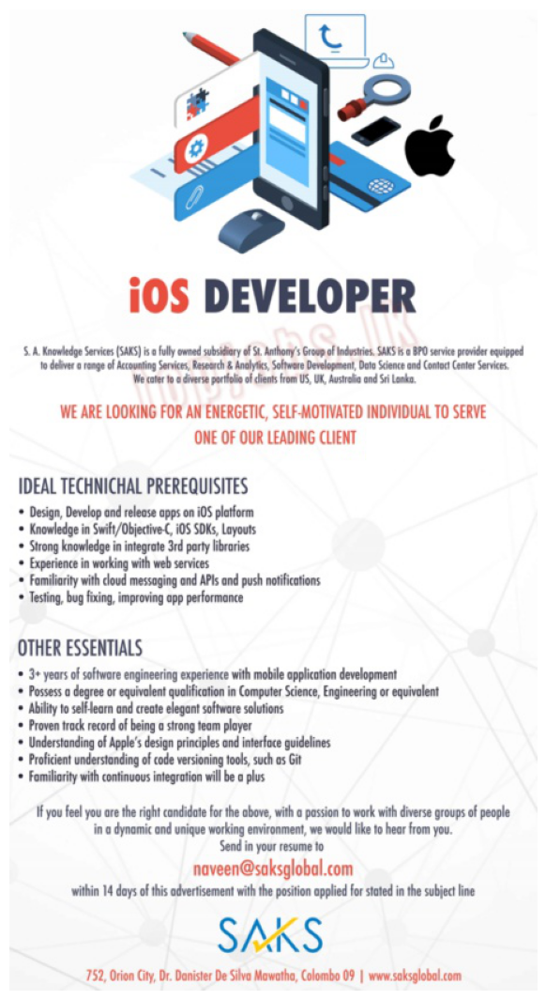

In [9]:
lwr1 = cv2.pyrDown(img)
# cv2.imwrite("temp/low-res.jpg", lwr1)
display("temp/low-res.jpg")

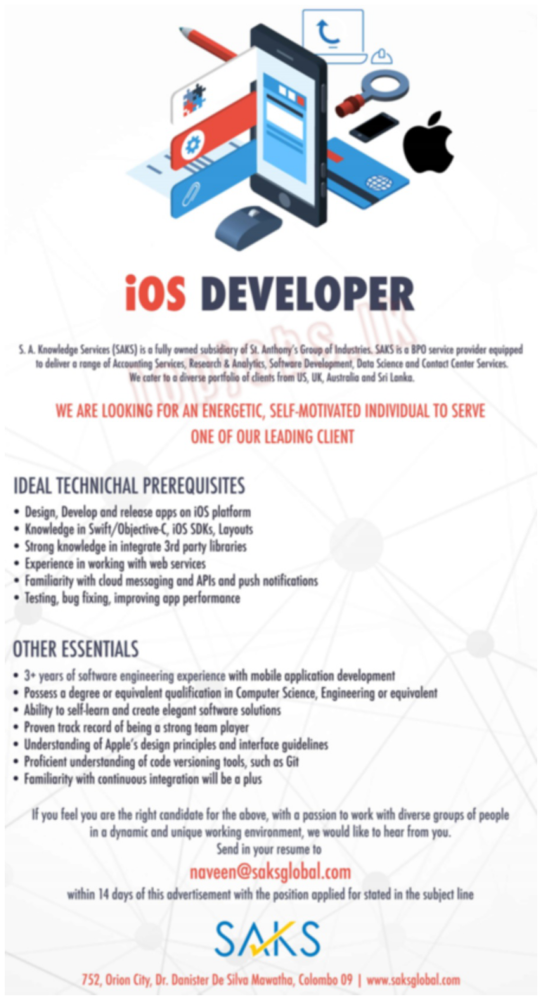

In [10]:
hir1 = cv2.pyrUp(lwr1)
#cv2.imwrite("temp/hi-res.jpg", hir1)
display("temp/hi-res.jpg")

In [13]:
sr = cv2.dnn_superres.DnnSuperResImpl_create()
path = "..\models/EDSR_x4.pb"
sr.readModel(path)
sr.setModel("edsr", 4)

In [14]:
result = sr.upsample(hir1)

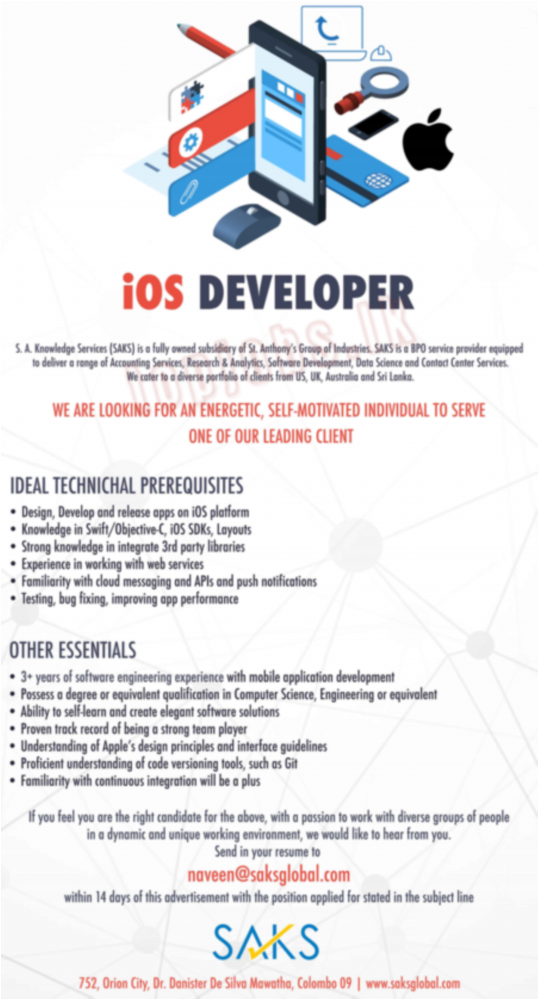

In [18]:
cv2.imwrite("temp/edsr-upscaled.jpg", result)
display("temp/edsr-upscaled.jpg")

In [16]:
lsr = cv2.dnn_superres.DnnSuperResImpl_create()
path = "..\models\LapSRN_X8.pb"
lsr.readModel(path)
lsr.setModel("lapsrn", 8)

In [17]:
result_lsr = lsr.upsample(lwr1)

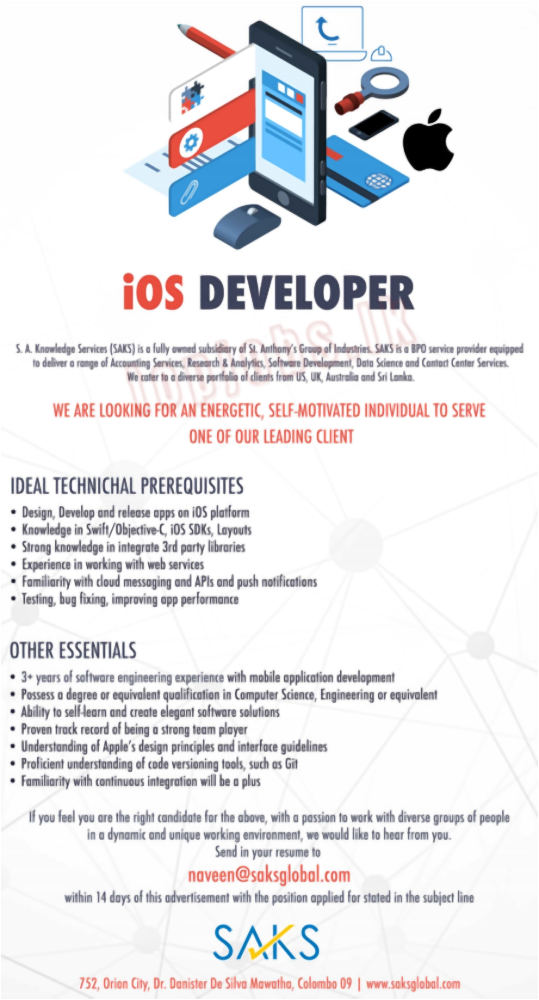

In [19]:
cv2.imwrite("temp/lsr-upscaled.jpg", result_lsr)
display("temp/lsr-upscaled.jpg")

- https://learnopencv.com/super-resolution-in-opencv/#sec2



- https://www.section.io/engineering-education/image-adjustment-to-higher-or-lower-resolution-using-python/#scaling-up-the-images-to-higher-resolutions 

## 03: Binarization

In [17]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#### Greying

In [18]:
gray_image = grayscale(img)
cv2.imwrite("temp/gray.jpg", gray_image)

True

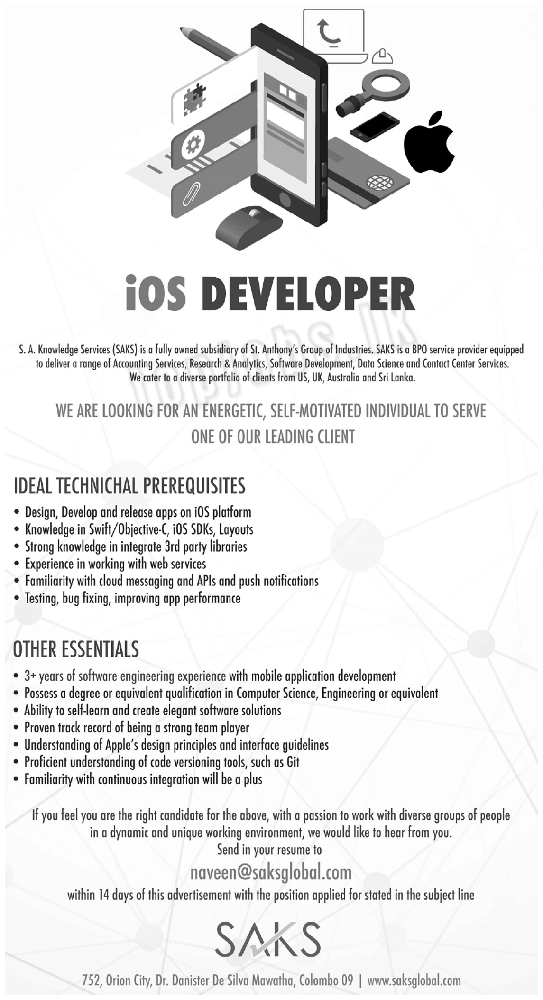

In [19]:
display("temp/gray.jpg")

#### Black and White 

In [20]:
thresh, im_bw = cv2.threshold(gray_image, 210, 230, cv2.THRESH_BINARY)
cv2.imwrite("temp/bw_image.jpg", im_bw)

True

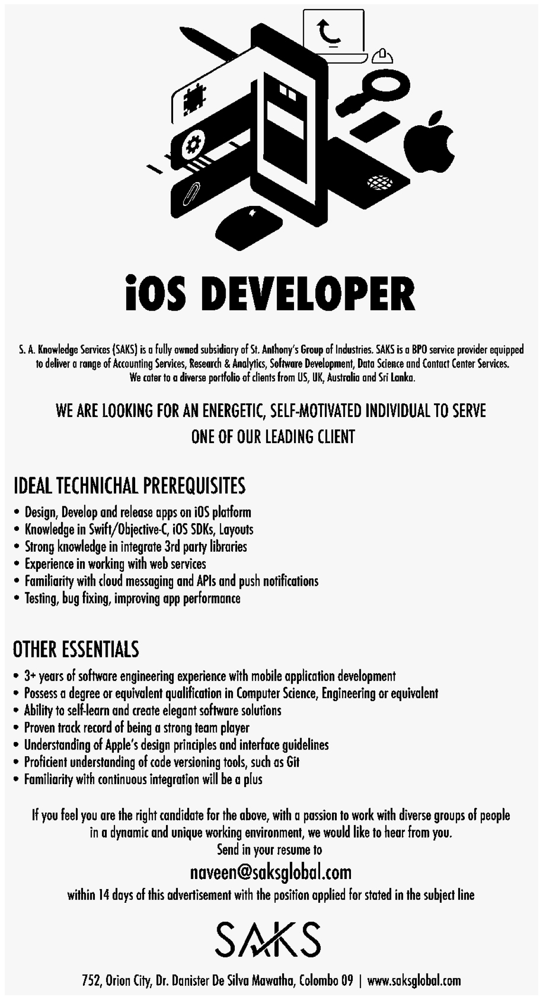

In [21]:
display("temp/bw_image.jpg")

## 04. Noise Removal

In [28]:
def noise_removal(image):
    import numpy as np
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return (image)

In [29]:
no_noise = noise_removal(im_bw)
cv2.imwrite("temp/no_noise.jpg", no_noise)

True

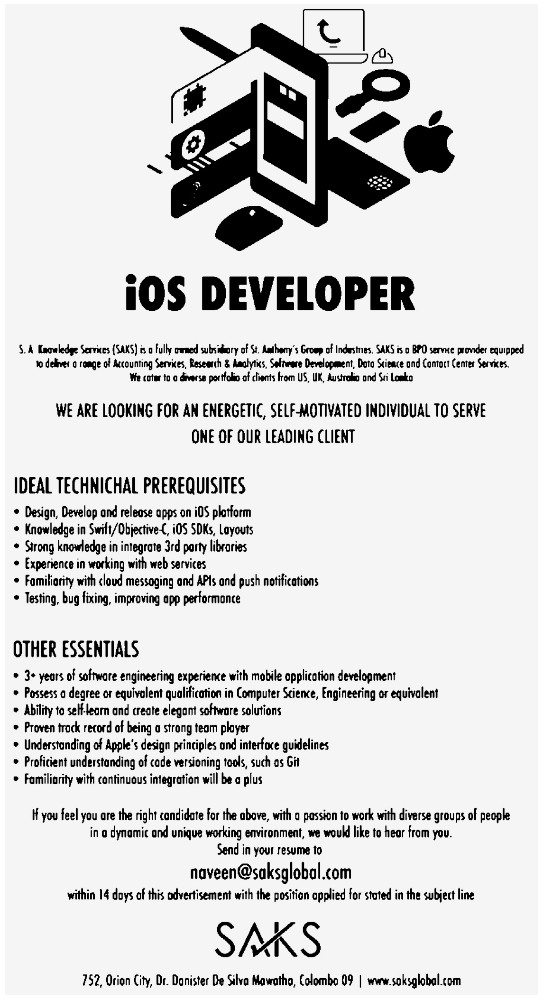

In [31]:
display("temp/no_noise.jpg")

## 05. Dilation and Erosion

#### Dilation

In [22]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [23]:
eroded_image = thin_font(img)
cv2.imwrite("temp/eroded_image.jpg", eroded_image)

True

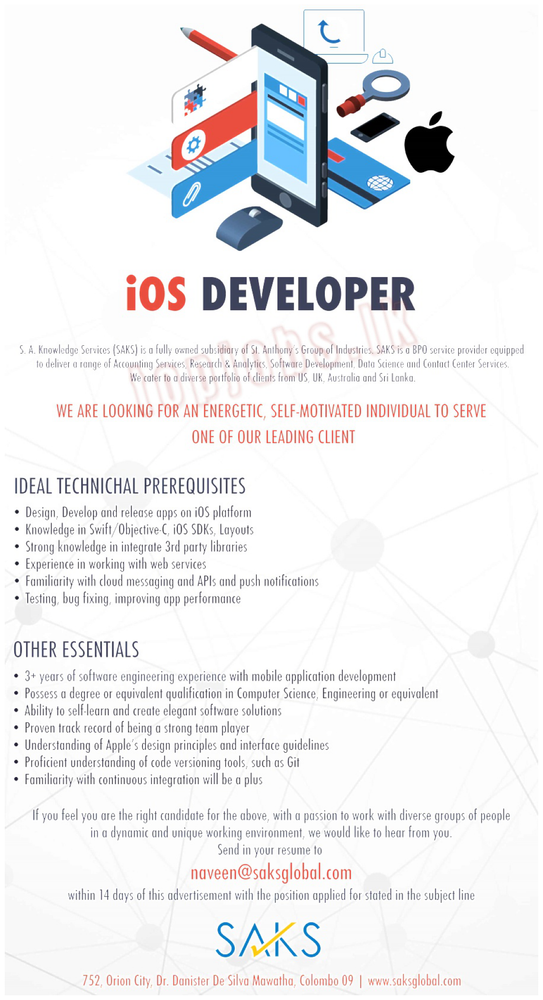

In [24]:
display("temp/eroded_image.jpg")

#### Erosion

In [25]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [26]:
dilated_image = thick_font(img)
cv2.imwrite("temp/dilated_image.jpg", dilated_image)

True

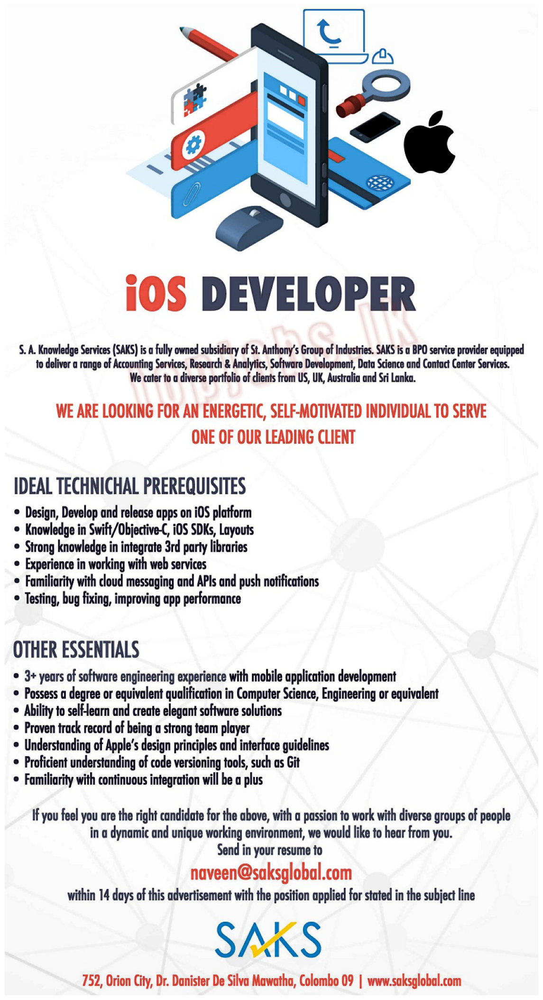

In [27]:
display("temp/dilated_image.jpg")

## 06: Rotation / Deskewing

In [32]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [33]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [34]:
#fixed = deskew(new)
#cv2.imwrite("temp/rotated_fixed.jpg", fixed)

## 07: Removing Borders

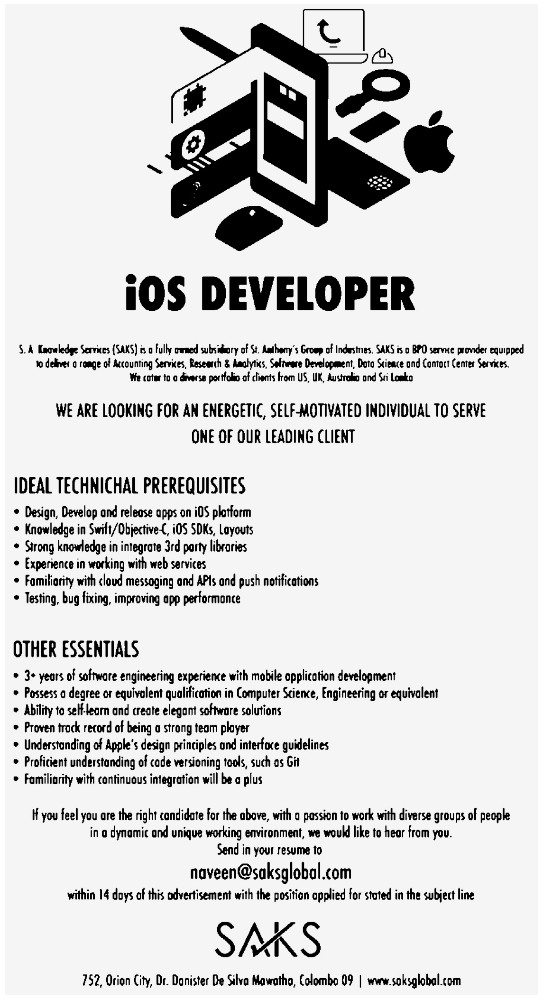

In [35]:
display("temp/no_noise.jpg")

In [36]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

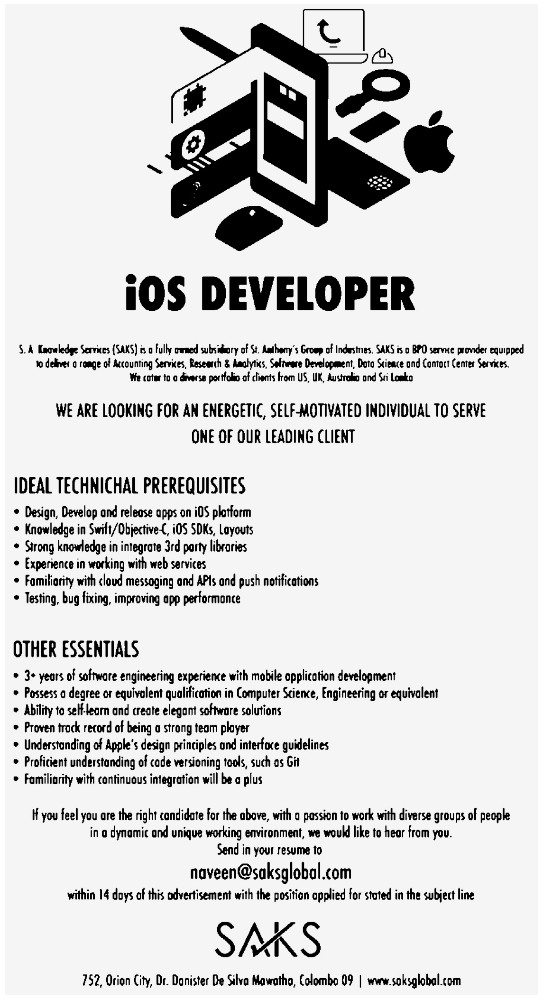

In [37]:
no_borders = remove_borders(no_noise)
cv2.imwrite("temp/no_borders.jpg", no_borders)
display('temp/no_borders.jpg')

## 08: Missing Borders

In [42]:
color = [255, 255, 255]
top, bottom, left, right = [150]*4

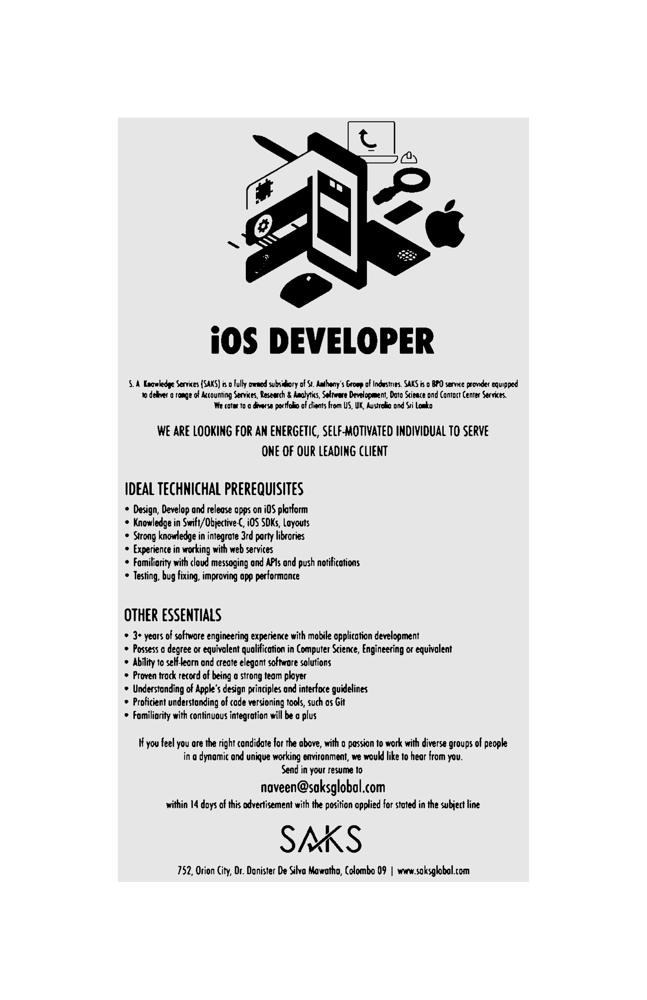

In [41]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("temp/image_with_border.jpg", image_with_border)
display("temp/image_with_border.jpg")

## 09: Transparency/Alpha Channel 